Main Updates:
- stocks saved as csv in /data/stocks
- change from from sktime.forecasting.arima import ARIMA to from statsmodels.tsa.arima.model import ARIMA (for some reason multiprocessing doesnt like sktime version)

Import packages

In [1]:
import os
import time
import re 
import sys
sys.path.append('..')

#to supress warnings 
import warnings 
warnings.filterwarnings('ignore')

import pandas as pd 
import numpy as np
import plotly.express as px
import plotly.offline as pyo

#to read stocks from Yahoo
from pandas_datareader.data import DataReader
import yfinance as yf 
from pandas_datareader import data as pdr
from datetime import datetime 

# for data encoding
import category_encoders as ce

# for stationarity checks
from statsmodels.tsa.stattools import adfuller
from statsmodels.graphics.tsaplots import plot_acf

from statsmodels.tsa.arima.model import ARIMA

pd.options.plotting.backend = "plotly"
pyo.init_notebook_mode()
yf.pdr_override()

Convert stock_data to a panel dataset 

In [2]:
import os
import pandas as pd

data_directory = '../data/stocks'
stock_symbols = ["AAPL", "MSFT", "GOOGL", "TSLA", "AMZN", "PLTR", "AMD", "NVDA", "META", "BAC"]
#stock_symbols = ["AAPL", "MSFT"]
# Dictionary to hold stock_data
stock_data = {}
final = []

for symbol in stock_symbols:
    file_path = os.path.join(data_directory, f'{symbol}.csv')
    
    # Read CSV file and load it into a DataFrame
    stock_df = pd.read_csv(file_path, index_col='Date', parse_dates=True)
    
    # Save the DataFrame to stock_data dictionary
    stock_data[symbol] = stock_df
    
    # Extract Close values and create a new DataFrame for panel_data
    vals = stock_df['Close'].tolist()
    tmp_df = pd.DataFrame()
    tmp_df['Series'] = [symbol] * len(vals)
    tmp_df['Date'] = stock_df.index
    tmp_df['Values'] = vals
    final.append(tmp_df)

# Concatenate all DataFrames for panel_data
panel_data = pd.concat(final)

# Set MultiIndex
panel_data.set_index(['Series', 'Date'], inplace=True)

# Display the panel_data
print(panel_data)

# Now, stock_data dictionary holds DataFrames for each stock symbol, and panel_data holds the final DataFrame
print(stock_data)

                      Values
Series Date                 
AAPL   2005-01-03   1.130179
       2005-01-04   1.141786
       2005-01-05   1.151786
       2005-01-06   1.152679
       2005-01-07   1.236607
...                      ...
BAC    2023-01-24  34.570000
       2023-01-25  34.869999
       2023-01-26  35.340000
       2023-01-27  35.450001
       2023-01-30  35.299999

[38298 rows x 1 columns]
{'AAPL':                   Open        High         Low       Close   Adj Close   
Date                                                                     
2005-01-03    1.156786    1.162679    1.117857    1.130179    0.959292  \
2005-01-04    1.139107    1.169107    1.124464    1.141786    0.969144   
2005-01-05    1.151071    1.165179    1.143750    1.151786    0.977632   
2005-01-06    1.154821    1.159107    1.130893    1.152679    0.978390   
2005-01-07    1.160714    1.243393    1.156250    1.236607    1.049628   
...                ...         ...         ...         ...         ...

Preprocessing and Checking Stationarity 
- differencing
- log transformation
- log diff returns

Then another preprocessing that focuses on converting the datetime index frequency and using ffill 

In [3]:
#Plotting: Overall Time Series first before preprocessing 
px.line(panel_data.reset_index(), 
        x = 'Date', 
        y = 'Values', 
        color = 'Series',
        title = 'Plot of Time Series')

In [4]:
#Check stationarity 
def check_stationarity(series):
    return adfuller(series, regression = 'c')[1]

In [5]:
# sort values first, then apply residual checks
results = panel_data.sort_values(by = ['Series', 'Date']).groupby(['Series'])['Values'].apply(check_stationarity)

# 100% of time series are not stationary
np.mean(results > .05)

1.0

In [6]:
#Preprocessing, differencing first
differences = panel_data.groupby(['Series'])['Values'].diff().reset_index().dropna()
results_diff = differences.groupby(['Series'])['Values'].apply(check_stationarity)
print("Proportion of non-stationary series after differencing:", np.mean(results_diff > .05))

# plot the differences
px.line(differences, x= 'Date', y = 'Values', color = 'Series')

Proportion of non-stationary series after differencing: 0.0


In [7]:
#Log transformation
log_returns = np.log1p(panel_data).groupby(['Series'])['Values'].diff().reset_index().dropna()
results_log = log_returns.groupby(['Series'])['Values'].apply(check_stationarity)
print("Proportion of non-stationary series after log returns:", np.mean(results_log > .05))

# plot the log differences
px.line(log_returns, x= 'Date', y = 'Values', color = 'Series')

Proportion of non-stationary series after log returns: 0.0


In [8]:
#Difference in log returns
final = []

for symbol in stock_symbols:
    print(f"Processing {symbol}...")

    vals = stock_data[symbol]['Close'].tolist()
    log_diffs = np.log(np.array(vals[1:]) / np.array(vals[:-1]))
    differences_log_diffs = log_diffs[1:] - log_diffs[:-1]
    
    tmp_df = pd.DataFrame()
    tmp_df['Series'] = [symbol] * len(differences_log_diffs)
    tmp_df['Date'] = stock_data[symbol].index[2:]  # Excluded the first two dates because log diff
    tmp_df['Values'] = differences_log_diffs
    final.append(tmp_df)

panel_data_log_diffs = pd.concat(final)
panel_data_log_diffs.set_index(['Series', 'Date'], inplace=True)

results_log_diffs = panel_data_log_diffs.groupby(['Series'])['Values'].apply(check_stationarity)
print("Proportion of non-stationary series after differencing log returns:", np.mean(results_log_diffs > .05))

panel_data_log_diffs_reset = panel_data_log_diffs.reset_index()
px.line(panel_data_log_diffs_reset, x= 'Date', y = 'Values', color = 'Series') 

Processing AAPL...
Processing MSFT...
Processing GOOGL...
Processing TSLA...
Processing AMZN...
Processing PLTR...
Processing AMD...
Processing NVDA...
Processing META...
Processing BAC...
Proportion of non-stationary series after differencing log returns: 0.0


In [9]:
panel_data_log_diffs

Values
Series Date                
AAPL   2005-01-05 -0.001498
       2005-01-06 -0.007945
       2005-01-07  0.069508
       2005-01-10 -0.074479
       2005-01-11 -0.061736
...                     ...
BAC    2023-01-24 -0.006531
       2023-01-25  0.001383
       2023-01-26  0.004748
       2023-01-27 -0.010281
       2023-01-30 -0.007348

[38278 rows x 1 columns]

In [10]:
dfs_list = []

#Get each stock symbol
symbols = panel_data_log_diffs.index.get_level_values('Series').unique()
for symbol in symbols:
    #subset dataframe per stock
    subset = panel_data_log_diffs.loc[symbol]

    #convert index to datetime to set frequency and use ffill
    subset.index = pd.to_datetime(subset.index)
    subset = subset.asfreq('B').fillna(method='ffill')

    #convert index back to a period and append series column
    subset.index = subset.index.to_period('D')
    subset['Series'] = symbol
    subset.set_index('Series', append=True, inplace=True)
    subset = subset.swaplevel('Series', 'Date')

    dfs_list.append(subset)

# Concatenate the processed dataframes
panel_data_processed = pd.concat(dfs_list)


In [11]:
panel_data_processed

Values
Series Date                
AAPL   2005-01-05 -0.001498
       2005-01-06 -0.007945
       2005-01-07  0.069508
       2005-01-10 -0.074479
       2005-01-11 -0.061736
...                     ...
BAC    2023-01-24 -0.006531
       2023-01-25  0.001383
       2023-01-26  0.004748
       2023-01-27 -0.010281
       2023-01-30 -0.007348

[39678 rows x 1 columns]

In [12]:
import pandas as pd
import numpy as np
from statsmodels.tsa.arima.model import ARIMA
import warnings
from statsmodels.tools.sm_exceptions import ConvergenceWarning
from multiprocessing import cpu_count
from joblib import Parallel, delayed
import logging

#Log to check if multiprocessing works 
logging.basicConfig(level=logging.INFO, format='%(asctime)s - %(levelname)s - %(message)s')

#Function to process each stock
def process_stock(stock, window_sizes, data):
    #Ignore the warnings from ARIMA model
    #But are these really harmless though?
    warnings.filterwarnings("ignore", category=ConvergenceWarning)
    warnings.filterwarnings("ignore", category=UserWarning)
    results = []

    #Log information about stock and data 
    logging.info(f"Processing stock: {stock} with data points: {len(data)}")

    for window_size in window_sizes:
        arima_predictions = []
        for i in range(len(data) - window_size):
            train_data = data.iloc[i:i + window_size]

            model = ARIMA(train_data, order=(1, 1, 0))
            results_arima = model.fit()
            y_pred = results_arima.forecast(steps=1)
            arima_predictions.append(y_pred.iloc[0])

        results.append((stock, window_size, arima_predictions))

    return results

def main():
    #Made panel_data_processed global so it can be accessed during multiprocessing
    global panel_data_processed  
    #Made results_dfs global 
    global results_dfs

    window_sizes = [3, 15, 30]
    stock_names = ["AAPL", "MSFT", "GOOGL", "TSLA", "AMZN", "PLTR", "AMD", "NVDA", "META", "BAC"]

    #Group arguments for process function in a tuple
    args = [(stock, window_sizes, panel_data_processed.loc[stock, 'Values'].dropna()) for stock in stock_names]

    #Get the number of cores, keep one free for other tasks just in case 
    num_cores = max(cpu_count() - 1, 1)

    #Process the stocks in parallel
    results_nested = Parallel(n_jobs=num_cores, batch_size=6)(delayed(process_stock)(stock, window_sizes, data) for stock, window_sizes, data in args)

    #Flatten the list of results, to get the desired output I want 
    #Parallel processing of stocks gives me a nested list 
    results_dfs = [item for sublist in results_nested for item in sublist]  

    # Log the results
    logging.info(f"Completed processing with {len(results_dfs)} result sets.")

    return results_dfs

if __name__ == "__main__":
    np.random.seed(0)

    results_dfs = main()

    print(results_dfs)


2023-10-25 20:41:31,619 - INFO - Completed processing with 30 result sets.


[('AAPL', 3, [0.05669364462051005, 0.045693055665801036, -0.06397345262680473, 0.10504995787709297, 0.06208511777486686, -0.11329765640414019, -0.05848103833323495, 0.0006763755142559694, -0.00729604509126237, -0.009750005087490892, 0.018089756858704332, -0.004559839667812404, 0.0247151101106269, 0.0036114614045523914, -0.013262579714654282, 0.021837748388606644, 0.027704114250224645, -0.01580121208403428, -0.03026845527583852, 0.01500112684587529, -0.04761909878817701, 0.029026574269535622, -0.010189415629381214, 0.0060018526328437585, -0.05094717990063085, 0.049165859582474145, 0.03440462584211468, 0.0019106266485310562, -0.03051622246476681, -0.06558435377719529, -0.022676678777748968, 0.014623935184664085, -0.006211259585427812, 0.014686514513967075, 0.04830958690481105, -0.015839237760804085, 0.01896292351755499, 0.005146080758558772, -0.014922852400860998, -0.017679728623067412, -0.0013755673800701779, 0.076786701463602, -0.0645326626559661, -0.023308530312754504, 0.0496806636759

In [13]:
results_dfs

[('AAPL',
  3,
  [0.05669364462051005,
   0.045693055665801036,
   -0.06397345262680473,
   0.10504995787709297,
   0.06208511777486686,
   -0.11329765640414019,
   -0.05848103833323495,
   0.0006763755142559694,
   -0.00729604509126237,
   -0.009750005087490892,
   0.018089756858704332,
   -0.004559839667812404,
   0.0247151101106269,
   0.0036114614045523914,
   -0.013262579714654282,
   0.021837748388606644,
   0.027704114250224645,
   -0.01580121208403428,
   -0.03026845527583852,
   0.01500112684587529,
   -0.04761909878817701,
   0.029026574269535622,
   -0.010189415629381214,
   0.0060018526328437585,
   -0.05094717990063085,
   0.049165859582474145,
   0.03440462584211468,
   0.0019106266485310562,
   -0.03051622246476681,
   -0.06558435377719529,
   -0.022676678777748968,
   0.014623935184664085,
   -0.006211259585427812,
   0.014686514513967075,
   0.04830958690481105,
   -0.015839237760804085,
   0.01896292351755499,
   0.005146080758558772,
   -0.014922852400860998,
   -0.0

In [14]:
results_df = pd.DataFrame(columns=['Stock', 'Window Size', 'Date', 'Original Price', 'ARIMA Prediction'])

for stock, window_size, arima_predictions in results_dfs:
    data = panel_data_processed.loc[stock]['Values'].dropna()
    window_size_predictions = arima_predictions
    date_index = data.index[-len(window_size_predictions):]
    original_prices = data.values[-len(window_size_predictions):]
    
    stock_results = pd.DataFrame({
        'Stock': [stock] * len(window_size_predictions),
        'Window Size': [window_size] * len(window_size_predictions),
        'Date': date_index,
        'Original Price': original_prices,
        'ARIMA Prediction': window_size_predictions
    })

    results_df = pd.concat([results_df, stock_results], ignore_index=True)

results_df

,Stock,Window Size,Date,Original Price,ARIMA Prediction
0,AAPL,3,2005-01-10,-0.074479,0.056694
1,AAPL,3,2005-01-11,-0.061736,0.045693
2,AAPL,3,2005-01-12,0.079777,-0.063973
3,AAPL,3,2005-01-13,0.050350,0.105050
4,AAPL,3,2005-01-14,-0.058481,0.062085
...,...,...,...,...,...
118549,BAC,30,2023-01-24,-0.006531,0.015634
118550,BAC,30,2023-01-25,0.001383,-0.005600
118551,BAC,30,2023-01-26,0.004748,-0.002682
118552,BAC,30,2023-01-27,-0.010281,0.003031


In [15]:
import pandas as pd
import numpy as np

arima_predictions_list = []

for stock in ["AAPL", "MSFT", "GOOGL", "TSLA", "AMZN", "PLTR", "AMD", "NVDA", "META", "BAC"]:
    stock_df = stock_data[stock]
    stock_df.index = pd.to_datetime(stock_df.index)

    for window_size in [3, 15, 30]:
        stock_window_df = results_df[(results_df['Stock'] == stock) & (results_df['Window Size'] == window_size)]
        
        for index, row in stock_window_df.iterrows():
            date = row['Date'].to_timestamp()
            arima_prediction = row['ARIMA Prediction']

            if date in stock_df.index:
                original_price = stock_df.loc[date]['Close']
                arima_prediction_transformed = original_price * np.exp(arima_prediction)
                
                arima_predictions_list.append({
                    'Stock': stock,
                    'Date': date,
                    'Original Price': original_price,
                    'Window Size': window_size, 
                    'ARIMA Prediction Transformed': arima_prediction_transformed
                })

final_arima_predictions_df = pd.DataFrame(arima_predictions_list)

#Use pivot to modify the dataframe to have a column for each window size
final_arima_predictions_df = final_arima_predictions_df.pivot_table(index=['Stock', 'Date', 'Original Price'], 
                                                                    columns='Window Size', 
                                                                    values='ARIMA Prediction Transformed', 
                                                                    aggfunc='first').reset_index()

new_columns = []

for col in final_arima_predictions_df.columns:
    if isinstance(col, int):  
        new_name = f'ARIMA Pred Window {col}'
        new_columns.append(new_name)       
    else:
        new_columns.append(col)

final_arima_predictions_df.columns = new_columns

final_arima_predictions_df



,Stock,Date,Original Price,ARIMA Pred Window 3,ARIMA Pred Window 15,ARIMA Pred Window 30
0,AAPL,2005-01-10,1.231429,1.303260,NaN,NaN
1,AAPL,2005-01-11,1.152857,1.206757,NaN,NaN
2,AAPL,2005-01-12,1.168929,1.096490,NaN,NaN
3,AAPL,2005-01-13,1.246429,1.384491,NaN,NaN
4,AAPL,2005-01-14,1.253571,1.333866,NaN,NaN
...,...,...,...,...,...,...
38244,TSLA,2023-01-24,143.889999,152.414901,152.208510,151.170231
38245,TSLA,2023-01-25,144.429993,126.250263,144.220261,143.379934
38246,TSLA,2023-01-26,160.270004,149.304990,153.978301,152.700524
38247,TSLA,2023-01-27,177.899994,216.204196,188.431327,184.685956


In [16]:
import pandas as pd
import numpy as np
from sklearn.metrics import mean_squared_error, mean_absolute_error, mean_absolute_percentage_error

metrics = []

def calculate_metrics(y_true, y_pred):
    # Remove NaN values
    mask = ~np.isnan(y_pred)
    y_true = y_true[mask]
    y_pred = y_pred[mask]

    mape = mean_absolute_percentage_error(y_true, y_pred)
    rmse = np.sqrt(mean_squared_error(y_true, y_pred))
    mae = mean_absolute_error(y_true, y_pred)
    
    return {
        "MAPE": mape,
        "RMSE": rmse,
        "MAE": mae,
    }

stocks = final_arima_predictions_df['Stock'].unique()

for stock in stocks:
    stock_df = final_arima_predictions_df[final_arima_predictions_df['Stock'] == stock]
    
    y_true = stock_df['Original Price']

    for window_size in [3, 15, 30]:
        y_pred = stock_df[f"ARIMA Pred Window {window_size}"]
        if y_pred.isna().all():  # Skip if all values are NaN
            continue

        metrics_values = calculate_metrics(y_true, y_pred)
        
        metrics.append({
            'Stock': stock,
            'Window Size': window_size,
            'MAPE': metrics_values['MAPE'],
            'RMSE': metrics_values['RMSE'],
            'MAE': metrics_values['MAE']
        })

# Create dataframe from metrics 
metrics_df = pd.DataFrame(metrics)

print(metrics_df)


    Stock  Window Size      MAPE      RMSE       MAE
0    AAPL            3  0.025146  2.043879  0.936319
1    AAPL           15  0.014180  1.184563  0.536828
2    AAPL           30  0.013257  1.111456  0.501191
3     AMD            3  0.042989  2.342202  1.025535
4     AMD           15  0.025122  1.325704  0.584446
5     AMD           30  0.023557  1.236337  0.547368
6    AMZN            3  0.027517  2.412302  1.101684
7    AMZN           15  0.015760  1.514452  0.645295
8    AMZN           30  0.014714  1.439390  0.606678
9     BAC            3  0.028855  1.066348  0.627650
10    BAC           15  0.016592  0.618366  0.356433
11    BAC           30  0.015724  0.590015  0.336706
12  GOOGL            3  0.021705  1.649880  0.846206
13  GOOGL           15  0.012538  0.985440  0.489563
14  GOOGL           30  0.011825  0.932044  0.464682
15   META            3  0.028365  6.523809  4.013559
16   META           15  0.016546  4.235791  2.367330
17   META           30  0.015428  4.027686  2.

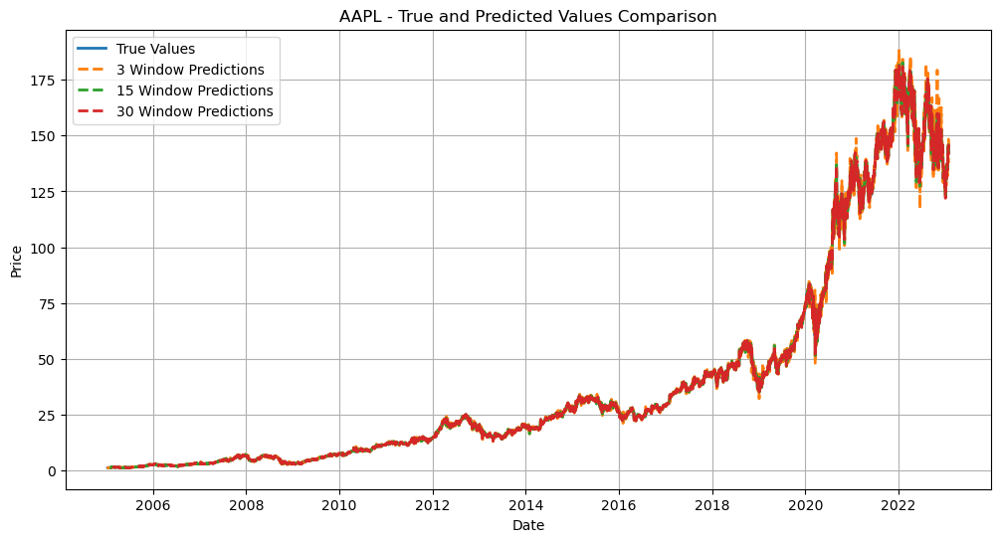

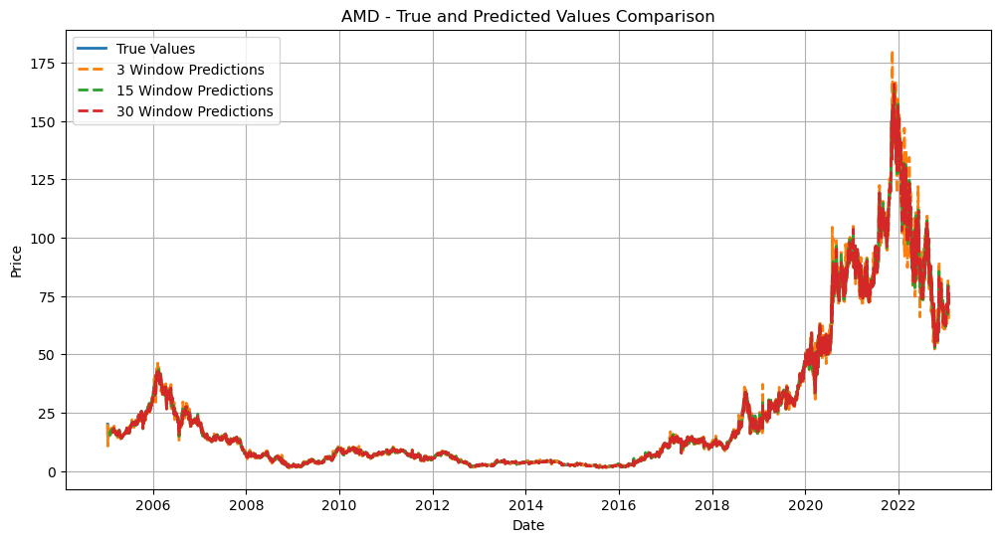

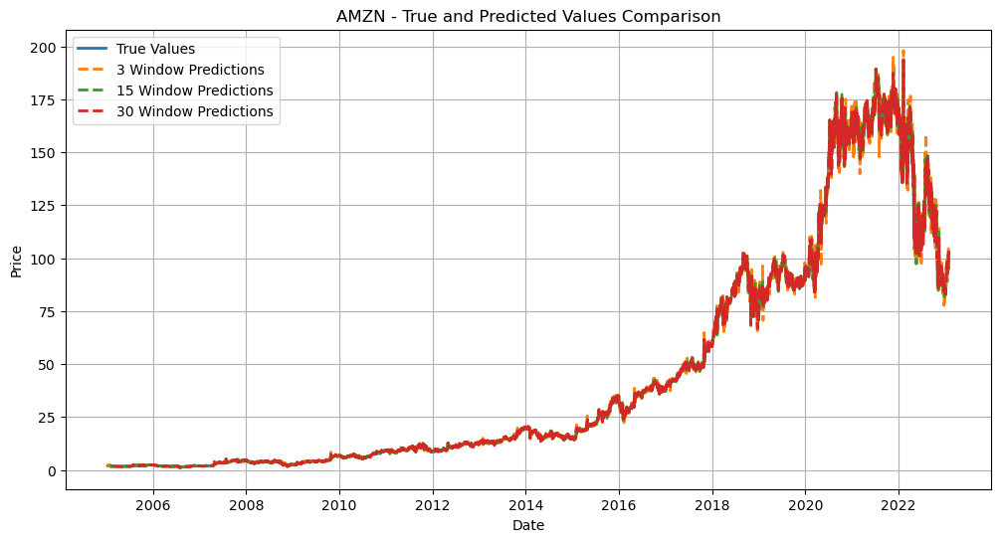

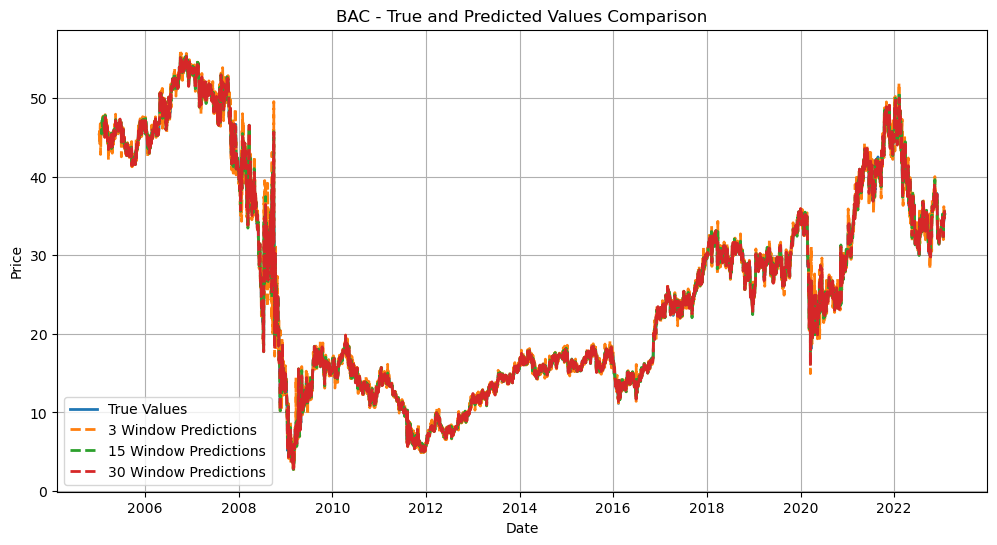

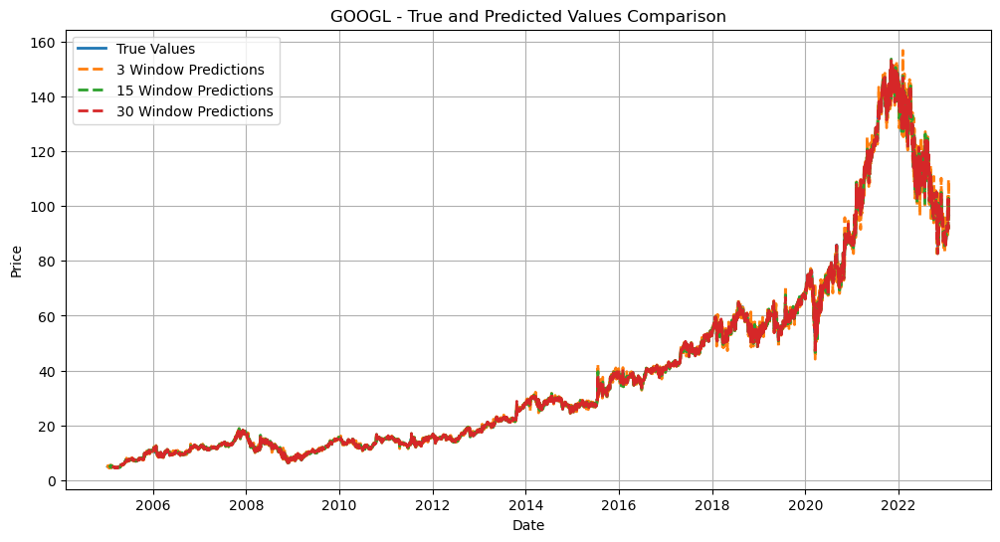

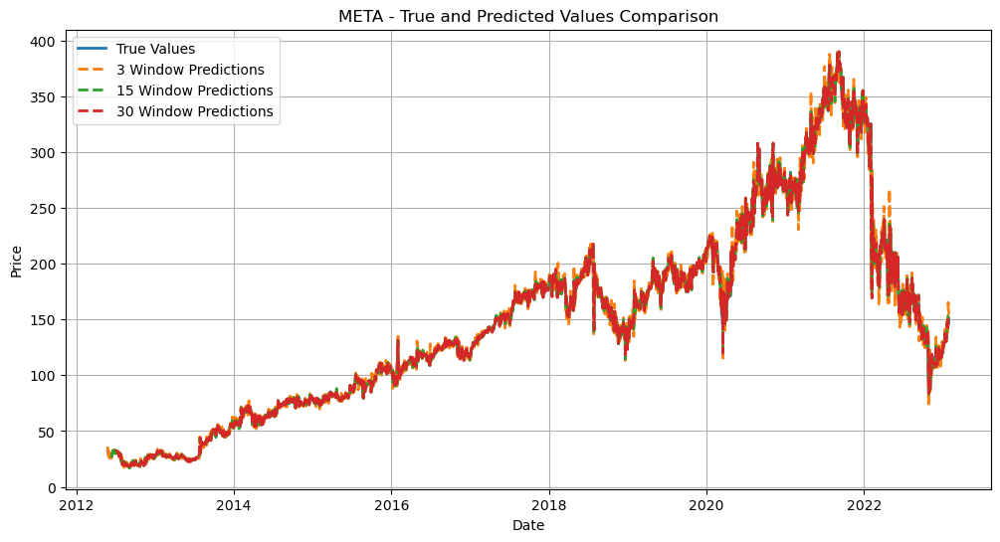

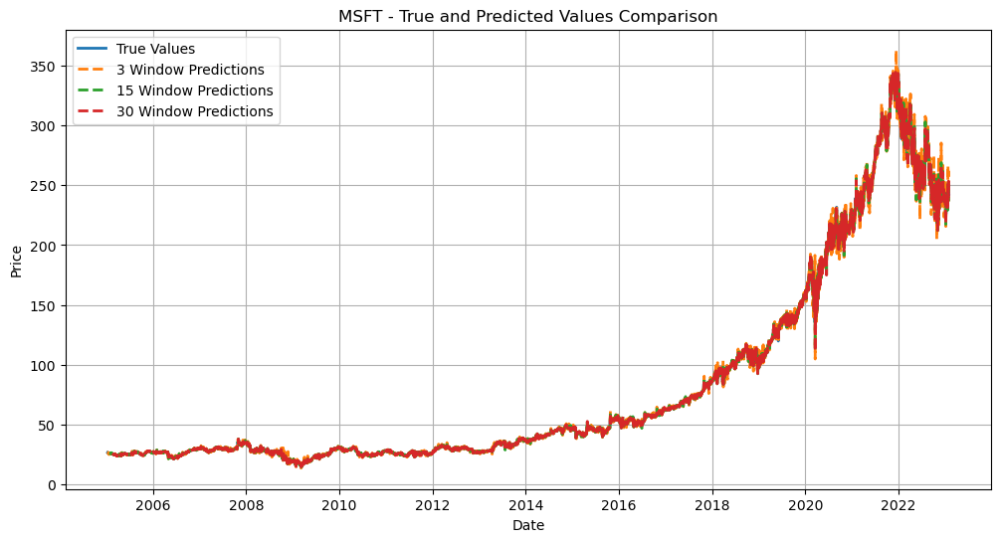

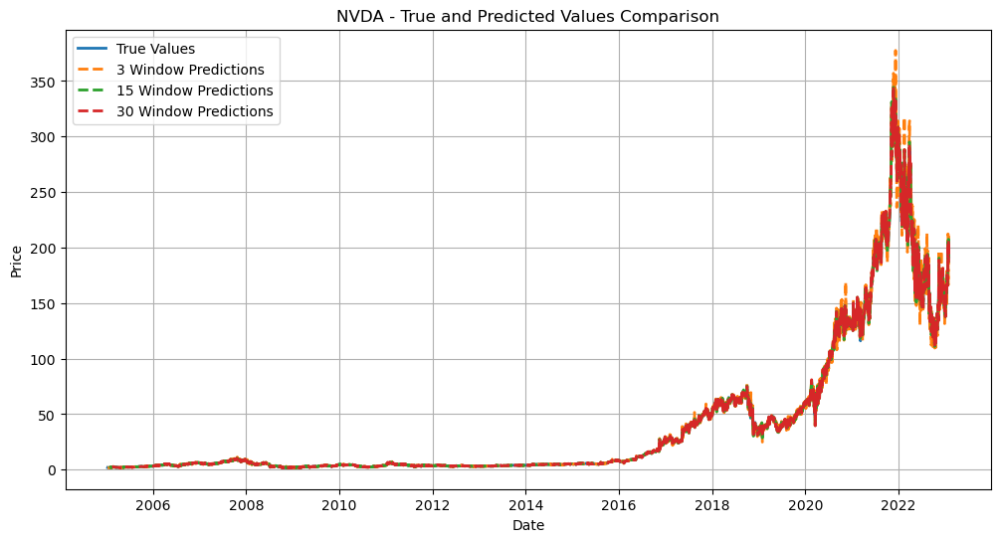

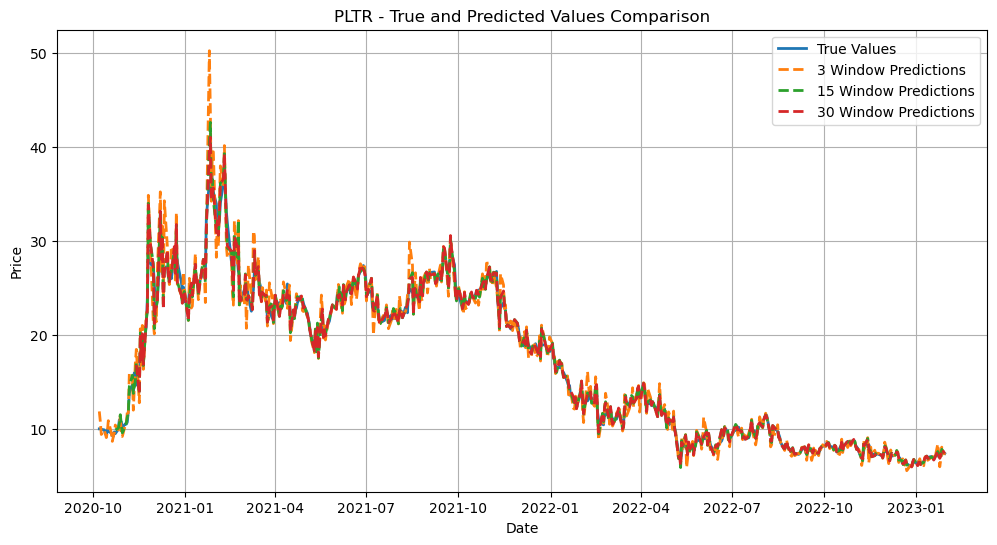

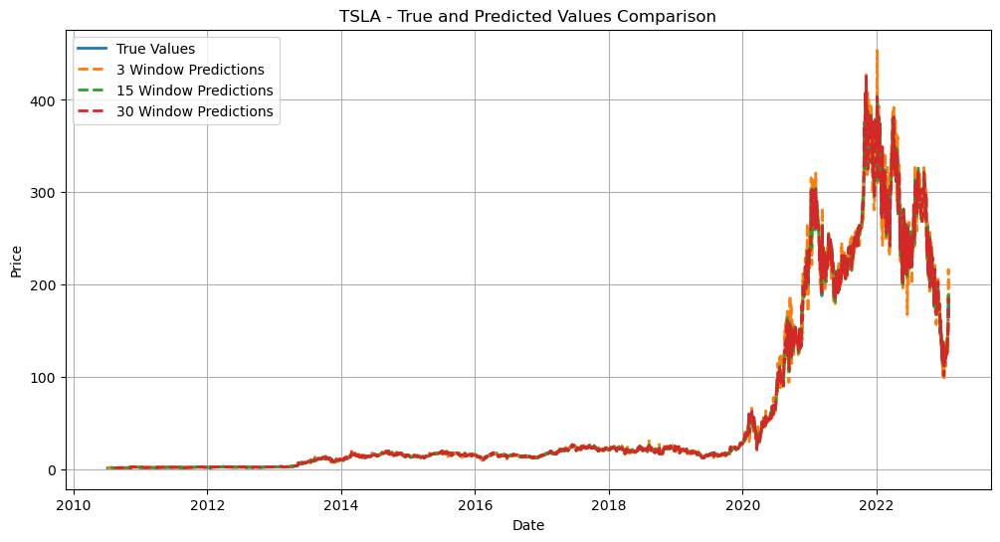

In [17]:
import os
import matplotlib.pyplot as plt
from datetime import datetime

base_dir = '../results'
now = datetime.now()
date_time_str = now.strftime('%Y%m%d_%H%M%S')
new_dir = os.path.join(base_dir, f"arima_experimental_{date_time_str}")

if not os.path.exists(new_dir):
    os.makedirs(new_dir)

window_sizes = [3, 15, 30]
stocks = final_arima_predictions_df['Stock'].unique()

final_arima_predictions_df.to_csv(os.path.join(new_dir, 'final_arima_predictions.txt'), sep='\t', index=False)
metrics_df.to_csv(os.path.join(new_dir, 'metrics.txt'), sep='\t', index=False)

for stock in stocks:
    filtered_df = final_arima_predictions_df[final_arima_predictions_df['Stock'] == stock]

    dates = filtered_df['Date']
    y_true = filtered_df['Original Price']

    plt.figure(figsize=(12, 6))
    plt.plot(dates, y_true, label='True Values', linewidth=2)

    for window_size in window_sizes:
        y_pred = filtered_df[f'ARIMA Pred Window {window_size}']
        plt.plot(dates, y_pred, label=f'{window_size} Window Predictions', linestyle='--', linewidth=2)

    plt.xlabel('Date')
    plt.ylabel('Price')
    plt.title(f'{stock} - True and Predicted Values Comparison')
    plt.legend()
    plt.grid(True)
    plt.savefig(os.path.join(new_dir, f'{stock}_plot.png'))

plt.show()


In [ ]:
import pandas as pd
import numpy as np
import warnings
from statsmodels.tsa.arima.model import ARIMA
from statsmodels.tools.sm_exceptions import ConvergenceWarning

# Filter out ConvergenceWarnings
warnings.simplefilter('ignore', ConvergenceWarning)

results_dfs = []

for stock in ['AAPL', 'MSFT']:
    data = panel_data_processed.loc[stock]['Values'].dropna()
    
    # Loop over different window sizes
    for window_size in [3, 15, 30]:
        arima_predictions = []
        
        for i in range(len(data) - window_size):
            train_data = data.iloc[i:i+window_size]

            # Fit a fixed ARIMA(1,1,0) model 
            model = ARIMA(train_data, order=(1, 1, 0))
            results = model.fit()

            # Make one-step-ahead forecasts
            y_pred = results.forecast(steps=1)

            arima_predictions.append(y_pred.iloc[0])

        results_dfs.append((stock, window_size, arima_predictions))

results_dfs
